# AMASUM Pre-Processing & Exploratory Data Analysis (EDA)

## Overview
This notebook outlines the initial steps towards building a sophisticated summarization model aimed at generating detailed summaries of Amazon Customer Reviews.

## Objectives
The primary goals of this notebook include:

1. **Data Ingestion:** Implementing a custom function to efficiently read Gunzipped JSON files from the Amazon Customer Review Datasets.
2. **Data Preparation:** Conducting a thorough inspection, cleaning, and merging of the datasets to ensure data quality and consistency.
3. **Exploratory Data Analysis:** Performing an in-depth analysis of the textual, temporal, and categorical aspects of the data to uncover key insights.
4. **Feature Engineering:** Iteratively developing and refining features essential for the effectiveness of our baseline and advanced models.

## Outcome
The process outlined in this notebook is critical for preparing a robust dataset, which will form the foundation for training and evaluating our summarization models.


In [1]:
import os
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import gzip
import json

---

### Data Loading

To load in our data we need to use a custom function to correctly parse the the json object into a pandas datframe. The code below was partially provided by the researchers who orignally sourced the data.

---

In [2]:
def parse(path):
    """
    Parses a Gzip-compressed JSON file and yields JSON objects one by one.

    Parameters:
    path (str): The path to the Gzip-compressed JSON file.

    Yields:
    dict: A JSON object read from the file.
    """
    # Open the Gzip-compressed file in binary read mode
    g = gzip.open(path, 'rb')
    # Iterate through each line (JSON object) in the file
    for l in g:
        # Parse and load the JSON object from the current line
        json_object = json.loads(l)
        # Yield the JSON object to the caller one by one
        yield json_object

def getDF(path):
    """
    Reads a Gzip-compressed JSON file and returns a pandas DataFrame.

    Parameters:
    path (str): The path to the Gzip-compressed JSON file.

    Returns:
    pandas.DataFrame: A DataFrame containing the data from the JSON file.
    """
    # Initialize a counter for DataFrame index
    i = 0
    # Create an empty dictionary to store JSON objects
    df = {}
    # Iterate through each JSON object returned by the 'parse' function
    for d in parse(path):
        # Add the JSON object to the dictionary with the current index as the key
        df[i] = d
        # Increment the index counter for the next JSON object
        i += 1

    # Create a pandas DataFrame from the dictionary
    # Using 'orient='index'' arranges the DataFrame where each row corresponds to an index (i)
    return pd.DataFrame.from_dict(df, orient='index')

### Data Inspection

In [3]:
# import main dataframe
df = getDF('/Users/williamfussell/Documents/local_capstone_master/capstone_data/capstone_reviewdata/Automotive_5.json.gz')

In [6]:
# import metadata
df_meta =getDF('/Users/williamfussell/Documents/local_capstone_master/capstone_metadata/meta_Automotive.json.gz')

---

Lets Inspect the data

---

In [7]:
df.shape

(1711519, 12)

---

Our data set is made up of 12 columns and ~1.7 Million Rows(Reviews)

---

In [8]:
# inspect the dataframe
df.head()

,overall,verified,reviewTime,reviewerID,asin,style,reviewerName,reviewText,summary,unixReviewTime,vote,image
0,4.0,False,"05 1, 2015",A8WEXFRWX1ZHH,0209688726,{'Color:': ' AC'},Goldengate,"After I wrote the below review, the manufactur...",Works well if you place phone in horizontally ...,1430438400,NaN,NaN
1,1.0,True,"04 19, 2018",ABCA1A8E4DGV1,0209688726,{'Color:': ' Blue'},noe,It sucks barely picks up anything definitely n...,sucks,1524096000,NaN,NaN
2,1.0,True,"04 16, 2018",A1NX8HM89FRQ32,0209688726,{'Color:': ' Black'},Eduard,"Well to write a short one, it blew 2 fuses of ...",Defective,1523836800,NaN,NaN
3,3.0,True,"04 13, 2018",A1X77G023NY0KY,0209688726,{'Color:': ' CA'},Lauren,I have absolutely no memory of buying this but...,Looks cool! Probably works,1523577600,NaN,NaN
4,5.0,True,"04 8, 2018",A3GK37JO2MGW6Q,0209688726,{'Color:': ' Black'},danny,it ok it does it job,Five Stars,1523145600,NaN,NaN


---

In our main Dataset we have:
- **overall**: Star Ratings
- **verified**: A boolean value verifying that the review has been checked to be legitimate.
- **reviewTime**: The day the review was posted
- **reviewerID**: Reviewer signifier
- **asin**: Product Id
- **style**: Color
- **reviewerName**: Name of reviewer
- **reviewText**: The actual body of the review
- **vote**: How many people upvoted the review
- **image**: Image uploaded along with the review

---


---

Check for null values

---

In [9]:
# check for null values
df.isna().sum()

overall                 0
verified                0
reviewTime              0
reviewerID              0
asin                    0
style             1118104
reviewerName          140
reviewText            866
summary               342
unixReviewTime          0
vote              1520651
image             1668825
dtype: int64

---

We see here that we have many mising values from vote, image, and style along with a smaller amount of null values from reviewer name, review text, and summary.

---

In [10]:
# check for verified reviews
df['verified'].value_counts()

verified
True     1630280
False      81239
Name: count, dtype: int64

### Data Cleaning

---

We check the verified reviews so that we can make sure the reviews we are analyzing are real.

We have a large amount of verified as well as a large dataset so lets drop the unverified reviews to keep this clean.

---

In [11]:
# drop reivews in verified column that are False
df = df[df['verified'] == True]

---

In order to create summaries for reviews we dont need all this excess data bogging up the code so lets drop the unneccesary columns.

---

In [12]:
# drop unneeded columns
df = df.drop(columns=['verified', 'reviewerName', 'reviewTime', 'style', 'image', 'vote', 'reviewerID'])

---

No that we have our needed columns and we such a small amount of missing values in them in proportion to the massive dataset lets drop the rows that have missing reviews and summaries.

---

In [13]:
# drop the rows with missing values
df = df.dropna()

df.isna().sum()

overall           0
asin              0
reviewText        0
summary           0
unixReviewTime    0
dtype: int64

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1629159 entries, 1 to 1711518
Data columns (total 5 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   overall         1629159 non-null  float64
 1   asin            1629159 non-null  object 
 2   reviewText      1629159 non-null  object 
 3   summary         1629159 non-null  object 
 4   unixReviewTime  1629159 non-null  int64  
dtypes: float64(1), int64(1), object(3)
memory usage: 74.6+ MB


---

Our final dataset contains the necessary columns:
- overall
- asin
- reviewText
- summary
- unixReviewTime

After filtering we now have ~1.6 Million columns for our analysis and modelling.

---

---

Next to have a bit more contect and to help with the application at the end of the process we will merge the corresponding metadata dataset with our original dataframe so that we can assign the product names or their 'title''s.

---

In [15]:
# Remove duplicates from df_titles
df_titles_unique = df_meta.drop_duplicates(subset='asin', keep='first')

# Merge with the original dataframe
df = pd.merge(df, df_titles_unique[['asin', 'title']], on='asin', how='left')


---

Well check for nulls.

---

In [16]:
# check for null values
df.isna().sum()

overall              0
asin                 0
reviewText           0
summary              0
unixReviewTime       0
title             2371
dtype: int64

---
We about 2K missing values so lets drop those as well.

---

In [17]:
# drop the rows with missing values
df = df.dropna()

### Pre-Processing and EDA

---

Lets take a look at the distribution of review ratings in our dataset.

---

In [18]:
# check the distribution of the ratings with plotly
import plotly.express as px

fig = px.histogram(df, x="overall")
fig.show()







---

Here we find conclusive evidence of a major imbalance in the data set with a overwhleming majority of reviews being rated 5 stars.

---

In [19]:
# check to see how many unique values are in the 'asin' column
df['asin'].nunique()



79250

---

Above we can see that of the ~1.6 million reviews there are ~80K unique products in the dataset.

---

---

Next to continue with somer further pre-processing, lets map the star ratings into sentiment categories and create a new "sentiment" column to store them.

---

In [20]:
# Replace overall ratings of 1&2 into 0, 3 into 1, and 4&5 into 2
replacement_dict = {1: 0, 2: 0, 3: 1, 4: 2, 5: 2}
df['sentiment'] = df['overall'].replace(replacement_dict)




In [21]:
df['sentiment'].value_counts()

sentiment
2.0    1410096
0.0     120140
1.0      96552
Name: count, dtype: int64

---

Following the trajectory of the star ratings we see the following:
- ***Positive Reviews***: 1,410,096
- ***Neutral Reviews***: 96,552
- ***Negative Review***: 120,140

---



In [22]:
# plot the distribution of the ratings with plotly
fig = px.histogram(df, x="sentiment")
fig.show()



---
Next we will look into some Temporal Analysis...in order to do this we need to change the unix data time to a datetime datatype with a time stamp.

---

In [8]:
# change unixReviewTime to datetime
df['unixReviewTime'] = pd.to_datetime(df['unixReviewTime'], unit='s')


In [24]:
df.head()

,overall,asin,reviewText,summary,unixReviewTime,title,sentiment
442,5.0,7138258917,Exactly what I wanted,Perfect,2016-03-03,Elite Mailers 9&quot;x2&quot; i-VTEC DOHC Viny...,2.0
443,5.0,7138258917,Very good quality product.,Five Stars,2016-11-26,Elite Mailers 9&quot;x2&quot; i-VTEC DOHC Viny...,2.0
444,5.0,7138258917,Great Customer Service. Great Product for the ...,Five Stars,2016-09-14,Elite Mailers 9&quot;x2&quot; i-VTEC DOHC Viny...,2.0
445,5.0,7138258917,Looks very sporty on my car,Very sporty,2016-06-15,Elite Mailers 9&quot;x2&quot; i-VTEC DOHC Viny...,2.0
446,5.0,7138258917,Just exact what i want..,Five Stars,2016-04-11,Elite Mailers 9&quot;x2&quot; i-VTEC DOHC Viny...,2.0


In [25]:
#find the earliest review date for each sentiment
print(df.groupby('sentiment')['unixReviewTime'].min())
print(df.groupby('sentiment')['unixReviewTime'].max())


sentiment
0.0   2005-05-24
1.0   2005-07-07
2.0   2000-09-14
Name: unixReviewTime, dtype: datetime64[ns]
sentiment
0.0   2018-09-30
1.0   2018-09-28
2.0   2018-10-03
Name: unixReviewTime, dtype: datetime64[ns]


---

We can see that our earliest date and latest dates were both positive reviews  with the earliest in September of 2000 and the latest in October of 2018...quite a laong range of time.

---

---

Lets do some EDA on the Reviews them selves.

---

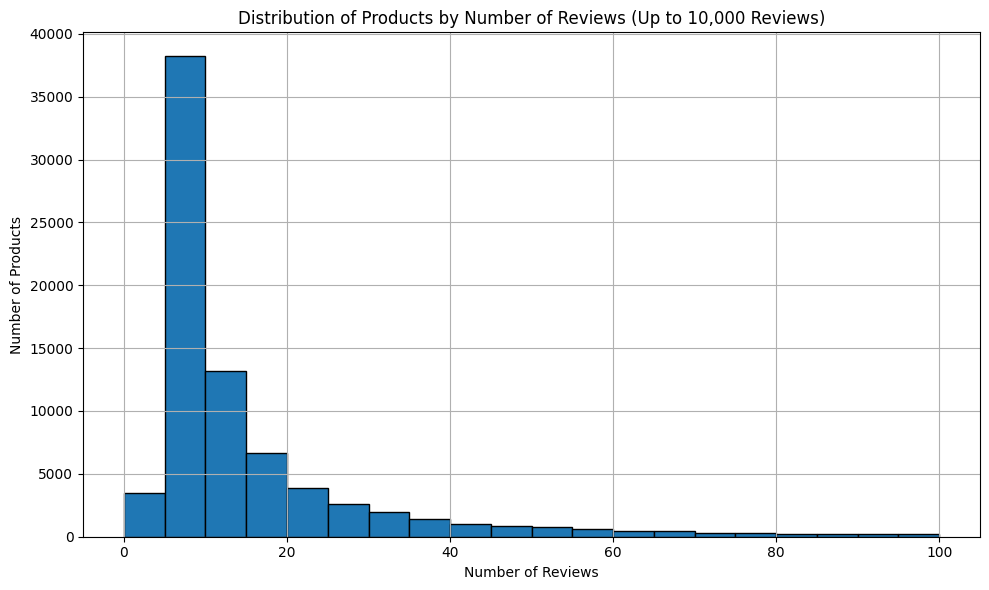

In [28]:
# distribution of products by how many reviews they have received

product_counts = df['asin'].value_counts()

# Plot the distribution with a custom x-axis range
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
plt.hist(product_counts, bins=20, range=(0, 100), edgecolor='k')
plt.xlabel('Number of Reviews')
plt.ylabel('Number of Products')
plt.title('Distribution of Products by Number of Reviews (Up to 10,000 Reviews)')
plt.grid(True)
plt.tight_layout()
plt.show()


In [29]:
# find the highest and lowest of amount reviews per product
print(product_counts.max())
print(product_counts.min())

4819
1


---

We can see most products have 5-10 reviews however there still thousands of products with thouands of reviews with some even having almost 5000 reviews.

---

In [30]:
# shortest and longest reviews
# Find the shortest review
shortest_review = df['reviewText'].str.len().min()

# Find the longest review
longest_review = df['reviewText'].str.len().max()

# Display the results
print("Shortest Review:", shortest_review)
print("Longest Review:", longest_review)

Shortest Review: 1
Longest Review: 18729


---

In fact one review even contained almost 19K words! Who can read all that!

---

---

Next we will extract elements from the datatime column for further temporal explorartion.

---

In [10]:
# Create a new column 'Year' by extracting the year from 'reviewTime'
df['Year'] = df['unixReviewTime'].dt.year

# Create a new column 'Month' by extracting the month from 'reviewTime'
df['Month'] = df['unixReviewTime'].dt.month

# Create a new column 'Day of Week' by extracting the day from 'reviewTime'
df['Day_of_Week'] = df['unixReviewTime'].dt.dayofweek



---

Lets see when the majority of reviews occured in the dataset.

---

Cutoff Year (Most Recent Year Contributing to 95%): 2013


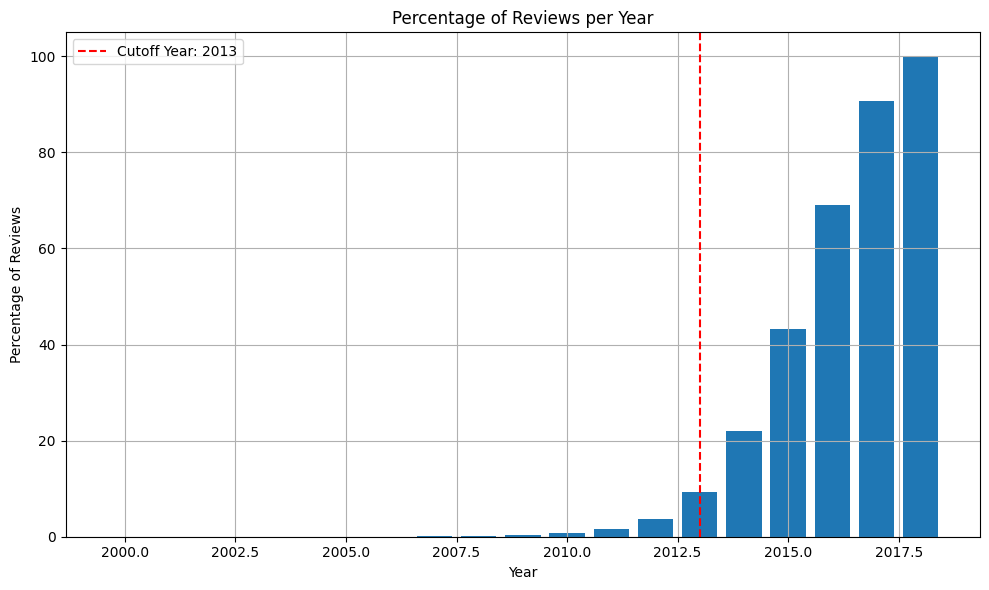

In [11]:
# Calculate the total number of reviews
total_reviews = len(df)

# Calculate the number of reviews in each year
reviews_per_year = df['Year'].value_counts().sort_index()

# Calculate the cumulative sum of reviews per year
cumulative_reviews_per_year = reviews_per_year.cumsum()

# Calculate the percentage of reviews per year
percentage_of_reviews_per_year = cumulative_reviews_per_year / total_reviews * 100

# Find the year where the cumulative percentage crosses 1%
cutoff_year = percentage_of_reviews_per_year[percentage_of_reviews_per_year >= 5].idxmin()

# Display the cutoff year (representing the most recent year contributing to 95%)
print("Cutoff Year (Most Recent Year Contributing to 95%):", cutoff_year)

# Create a bar plot of the percentage of reviews per year
plt.figure(figsize=(10, 6))
plt.bar(percentage_of_reviews_per_year.index, percentage_of_reviews_per_year)
plt.axvline(x=cutoff_year, color='red', linestyle='--', label=f'Cutoff Year: {cutoff_year}')
plt.xlabel('Year')
plt.ylabel('Percentage of Reviews')
plt.title('Percentage of Reviews per Year')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

---

Here we can see that even though the dataset stretches from 2000 to 2018 95% of the reviews were written after 2013. Showing a growing trend in reviews showing a strong use case for customer review summaries.

---

### Model Training Dataset Creation

---

First lets create a few new dataframes based on their sentiment scores:

---

In [31]:
# create new dataframes for negative, neutral, and positive sentiment
df_neg = df[df['sentiment'] == 0]
df_neu = df[df['sentiment'] == 1]
df_pos = df[df['sentiment'] == 2]

# reset the index of the new dataframes
df_neg = df_neg.reset_index(drop=True)
df_neu = df_neu.reset_index(drop=True)
df_pos = df_pos.reset_index(drop=True)


# check the shape of the new dataframes
df_neg.shape, df_neu.shape, df_pos.shape

((120140, 7), (96552, 7), (1410096, 7))

---

Before we can fine-tune the model we need to create reference summaries to use to show the model what to do.

In order to do this we need to concatenate the reviews together, but I have a few conditions I want to put on them to make sure they will work properly with my model.

I have found through some iteration that the best results using Llama 2 with Google Colab and a single Nvidia A100 GPU that the data set should contain the following:

- Reviews that have at least 10 reviews

- Concatenatedr reviews should contain no more than 600 words

We can expand this later with more powerful compute.

---

In [34]:
# Step 1: Filter groups with at least 10 entries in df_pos
df_at_least_10_pos = df_neg.groupby('asin').filter(lambda x: len(x) >= 10)

# Step 2: Aggregate 'reviewText' by 'asin' in df_pos, prepending each review with a bullet
df_aggregated_pos = df_at_least_10_pos.groupby(['asin','title'])['reviewText'].agg(lambda x: '\n'.join(x.astype(str))).reset_index()

# Step 3: Filter the aggregated DataFrame to keep entries where the total word count is less than 600
df_neg_sample = df_aggregated_pos[df_aggregated_pos['reviewText'].apply(lambda text: len(str(text).split()) < 600)]

# Step 1: Filter groups with at least 10 entries in df_pos
df_at_least_10_pos = df_pos.groupby('asin').filter(lambda x: len(x) >= 10)

# Step 2: Aggregate 'reviewText' by 'asin' in df_pos
df_aggregated_pos = df_at_least_10_pos.groupby(['asin','title'])['reviewText'].agg(lambda x: '\n'.join(x.astype(str))).reset_index()

# Step 3: Filter the aggregated DataFrame to keep entries where the total word count is less than 600
df_pos_sample = df_aggregated_pos[df_aggregated_pos['reviewText'].apply(lambda text: len(str(text).split()) < 600)]


In [35]:
df_neg_sample.shape

(827, 3)

In [36]:
df_pos_sample.shape

(17894, 3)

---

Great... now lets add negative and positieve sentiment columns to the dataframes for clarity.

---

In [37]:
# add the sentiment column to the dataframes
df_neg_sample.loc[:, 'sentiment'] = 'negative'
df_pos_sample.loc[:, 'sentiment'] = 'positive'


/var/folders/gk/9xw5jgd926n3pd56srj9xpx80000gn/T/ipykernel_77874/2883340869.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



---

We will reset the index and then sample fro the positive dataaset to match closer to the negative dataframe.

Later we will train on the larger datasets.

---

In [38]:
#reset the index of the new dataframes
df_neg_sample = df_neg_sample.reset_index(drop=True)

In [39]:
# reset the index of the new dataframes 
df_pos_sample = df_pos_sample.reset_index(drop=True)


In [41]:
# sample 1000 reviews from the positive and negative sentiment dataframe
df_pos_sample = df_pos_sample.sample(1000, random_state=42)



In [42]:
# count the number of total reviews in each sentiment dataframe
print(df_neg_sample['reviewText'].count())

print(df_pos_sample['reviewText'].count())

827
1000


In [141]:
# export the dataframes to json files
df_neg_sample.to_json('/Users/williamfussell/Downloads/df_neg_sample.json')
df_pos_sample.to_json('/Users/williamfussell/Downloads/df_pos_sample.json')

---

Next, we will send these dataframes off to create the reference summaries for training. We will utilize a python script calling the Open AI API for this procedure.

Please the script for further details.

---


### FINAL DF CREATION

Here we will read in the reference summaries that were generated using GPT 3.5 Turbo from the cript we ran over-night. For a bit of final processing before training.

---

In [46]:
# check summary df
df_test_neg = pd.read_json('/Users/williamfussell/Downloads/negative_review_summaries_final.json')
df_test_pos = pd.read_json('/Users/williamfussell/Downloads/positive_review_summaries_final.json')

---

A couple of the summaries didnt work properly so well drop the ones that returned null values.

---

In [47]:
# drop the rows with missing values
df_test_neg = df_test_neg.dropna()
df_test_pos = df_test_pos.dropna()

---
### Prompt Engineering

Next we need to create something integral to fine-tuning Llama2, the prompt. Here we will generate an alpaca style prompt with three portions:

- **Instruction**: This will tell the model what we want it to be.

- **ReviewText**: This will be the actual body of the reviews.

- **RefernceSumary**: This will show the model what we expect the answer to be...it serves essentilaly like a label for summarization.

---

In [48]:
#create alpaca style prompt

def create_prompt_column(df):
    # Define the system prompt and other constants
    SYSTEM_PROMPT = "Below is a group of reviews for a product. Summarize the following reviews in no more than 120 words .Provide three bullet points highlighting the most discussed topics and their associated issues. Keep the summary concise and focused on the key points."

    # initilize an empty list 
    prompts = []

    # terate through each row of the DataFrame
    for index, row in df.iterrows():
        # extract the 'reviewText' and 'summary' from the current row
        review_text = row['reviewText']
        summary = row['summary']

        # create the prompt for this row
        prompt = f"### Instruction:\n\n{SYSTEM_PROMPT}\n\n### Input:\n\n{review_text}\n\n### Response:\n\n{summary}"

        # append the prompt to the list
        prompts.append(prompt)

    # Add the prompts as a new 'prompt' column in the DataFrame
    df['prompt'] = prompts

    return df

In [49]:
create_prompt_column(df_test_neg)
create_prompt_column(df_test_pos)

,asin,title,reviewText,summary,prompt
0,B0012TYYKU,Show Chrome Replacement Black Grommets Honda 5...,looks good a lot cheaper than oem\nThese items...,- Users are satisfied with the price and quali...,### Instruction:\n\nBelow is a group of review...
1,B00NGT7QI6,Polaris 2879969 Rear View Mirror,Wide view.\nGood product\nFit my '17 570 range...,"- Mirror fits well and provides a wide view, b...",### Instruction:\n\nBelow is a group of review...
2,B00GHT95EK,DORMAN 924-807 Replacement Center Console Latch,Fits perfectly and so much better than the dea...,- Fits perfectly and better than the dealer's ...,### Instruction:\n\nBelow is a group of review...
4,B0078U83CM,Yukon Gear &amp; Axle (AK 1559) Torrington 2.5...,appears to be the same Torrington brand as OEM...,- The product does not fit an 06 F150 XLT Ext ...,### Instruction:\n\nBelow is a group of review...
5,B009LZTZ2Y,Dorman 901-503 Power Window Switch,I got this switch not because mine was bad but...,- Defect with paint on 06-09 year model VW Pas...,### Instruction:\n\nBelow is a group of review...
...,...,...,...,...,...
995,B000GKD722,Xtra Seal Bead Sealer,We ran out of bead sealer and none was availab...,- The bead sealer is highly effective in seali...,### Instruction:\n\nBelow is a group of review...
996,B000PSL68C,ProMAG Paintable Magnetic Vinyl Sheet,"Did the job, its magnet is not that strong, bu...",- The magnet strength of the product is a comm...,### Instruction:\n\nBelow is a group of review...
997,B018F9KQ3S,"ARKSEN Electric Power Tongue 12v - 3500 LBS, T...","works well\nGreat product, easy to install and...",- Easy to install and works great: Users were ...,### Instruction:\n\nBelow is a group of review...
998,B000EVU8X4,Equus 6242 2&quot; Mechanical Water Temperatur...,The exact product I wanted at the price I was ...,- The product description could have been impr...,### Instruction:\n\nBelow is a group of review...


In [50]:
print(df_test_neg['prompt'][0])

### Instruction:

Below is a group of reviews for a product. Summarize the following reviews in no more than 120 words .Provide three bullet points highlighting the most discussed topics and their associated issues. Keep the summary concise and focused on the key points.

### Input:

product is in good shape but very small. wasn't able to use. they look bigger in the pic but they are about the size of my hand
Walmart and Auto-Zone has these for 1/2 the price, locally.
When screwing this in it was dented by my filter wrench. Metal is thin an susceptible to denting. Audi oem filter when compared to this has stronger metal. Would  it buy again.
Very bad had pin hole near the top
looks like a scam this funnel is tiny the opening is about 3 inches across not much of a funnel.
Garbage.  Does not fit well and does not look like the photos. I recommend not to purchase this item.
It's a fine product, but the day after I bought it on Amazon I saw it in an auto parts store for $1.10. Wish I'd gon

---

Great, lets shuffle the datasets so that the model doesnt try to memorize anything potentially ovverfit to the data.

---

In [51]:
#shuffle_data_sets
negative_df_final = df_test_neg.sample(frac=1.0, random_state=42)

positive_df_final = df_test_pos.sample(frac=1.0, random_state=42)


In [52]:
# reset the index of the new dataframes
negative_df_final = negative_df_final.reset_index(drop=True)
positive_df_final = positive_df_final.reset_index(drop=True)

In [53]:
negative_df_final.head()

,asin,title,reviewText,summary,prompt
0,B00VL4H78W,"Motorcycle Driving Lights, Ourbest 2inch Round...",Good item just wasn't what I thought. But the ...,"- The lights have durability issues, with the ...",### Instruction:\n\nBelow is a group of review...
1,B002GQD2P6,Hiltex 50604 10&quot; Coil Spring Compressors ...,"Ear broke first time used, flew across the gar...","- The tool broke or malfunctioned during use, ...",### Instruction:\n\nBelow is a group of review...
2,B00180J4SU,Moog K6203-2 Coil Spring Insulator,Did not fit listed App. The car does not even ...,- The reviewer expresses dissatisfaction with ...,### Instruction:\n\nBelow is a group of review...
3,B00499YC4I,SYLVANIA 7506 SilverStar High Performance Mini...,"I recievied item on april 1, 2017 i installed ...",- The reviewer received and installed the bulb...,### Instruction:\n\nBelow is a group of review...
4,B00F0QAOOG,Auto Ventshade 194528 Smoke Side Window Deflector,This item does not fit a 2014 Crew Cab 1500 Si...,- The item does not fit properly on a 2014 Cre...,### Instruction:\n\nBelow is a group of review...


In [54]:
positive_df_final.head()

,asin,title,reviewText,summary,prompt
0,B001GG05ZM,"NS-FX PALM TREES - Tropical Beach - Car, Truck...",Looks great on my yeti.\nlooks cool on my lapt...,- Positive remarks about the appearance and qu...,### Instruction:\n\nBelow is a group of review...
1,B00O4CSDM2,"ZANheadgear Neoprene Full Face Mask, Vintage Flag",Runs a little small. I have a big head. Size ...,- Reviewer mentions that the mask runs a littl...,### Instruction:\n\nBelow is a group of review...
2,B00GI77HZK,Pilot Automotive (IL-194A-5-AM) Amber 5-SMD LE...,Installed in my Ford Fusion as side marker lig...,- Bright and good-looking side marker lights i...,### Instruction:\n\nBelow is a group of review...
3,B0012RN3A4,Tow Ready 118372 T-One Connector with Converter,This has to be the easiest installation of any...,- The reviewer emphasizes how easy the install...,### Instruction:\n\nBelow is a group of review...
4,B00Y1HG6BA,Bully BBS-1104L Black Hitch Mounted Utility St...,Very good tailgater deterrent. Fits nicely wit...,- The tailgater deterrent is considered very g...,### Instruction:\n\nBelow is a group of review...


---

Wonderful, our data is ready to go and ready for training.

The final and very important thing to do here is to load it into the HuggingFace Hub so that it can work correctly with their Trasnformers SFTTrainer.

In order to do this we need to transform the dataframe into JSONL files so that they read appropriately into the hub.

---

In [95]:
negative_df_final = negative_df_final.to_dict(orient = 'records')

positive_df_final = positive_df_final.to_dict(orient = 'records')



In [96]:
# function to convert df to jsonl
with open('/Users/williamfussell/Downloads/train.jsonl', 'w') as f:
    for line in negative_df_final:
        f.write(json.dumps(line) + '\n')

In [ ]:
# function to convert df to jsonl
with open('/Users/williamfussell/Downloads/train.jsonl', 'w') as f:
    for line in positive_df_final:
        f.write(json.dumps(line) + '\n')

# Conclusion

#### We now have a pre-processed dataset with more than enough EDA to back up hte claim and need for a project like this. Lets proceed to the Modeling Notebooks in a Google Colab environment to fine-tune the model.